# Implementing U-Net for semantic segmentation on Oxford-IIIT Pet Dataset - Deep Learning for Artificial Intelligence (CCE PROFICIENCE JAN 2023)

---

**Student Name:**  Himanshu Pant, Koelgeet Kaur, Pratheeksha, Stan Iyer, Sanjeev, Sai Manikanta Mukka

**User ID:**    hpant438, Saimanikantamukka, koelgeetkaur45, stan.iyer, pratheeksha.pn95, sanjeev1110

**Email ID:**    hpant438@gmail.com, koelgeetkaur45@gmail.com, Saimanikantamukka@gmail.com, stan.iyer@gmail.com, pratheeksha.pn95@gmail.com, sanjeev1110@gmail.com

**Date of submission:**    April, 2023

**Deadline of submission:** 15th April, 11:59 PM

---

## Description:
This project outlines the segmentation approach using U-Net to extract only pet images fromt each of the test images. The same approach will be used for the satellite cloud identification use case.

## Import necessary modules.

In [ ]:
# Frameworks for comprehensive mathematical functions 
import numpy as np
import pandas as pd
import math
import joblib
import random
import os

# Deep Learning frameworks
import tensorflow as tf
# from tensorflow.keras import layers
from tensorflow.keras.models import Model
from tensorflow import keras

# Importing Layers
from keras import layers
from keras.layers import Dense, Flatten, Concatenate
from keras.layers import Rescaling, RandomFlip, RandomRotation, RandomZoom
from keras.layers import Conv2D, MaxPooling2D, Dropout
from keras import Input
from keras.layers.serialization import activation
from keras.models import Sequential

# Visualisation of model
import matplotlib.pyplot as plt
from keras.utils import plot_model
import seaborn as sns
from matplotlib.image import imread

# Dataset from keras repository
import tensorflow as tf
from tensorflow import keras
import tensorflow_datasets as tfds
from keras.utils import image_dataset_from_directory

# Callbacks imports from keras
from keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard

# Filter warnings
import warnings
warnings.filterwarnings('ignore')

# Set random seed for Python's built-in random module
SEED = 42
random.seed(SEED)

# Set random seed for NumPy
np.random.seed(SEED)

# Set random seed for TensorFlow
tf.random.set_seed(SEED)

## Load Dataset

In [ ]:
oxford_iiit_pet_dataset, info = tfds.load('oxford_iiit_pet:3.*.*', with_info=True)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/oxford_iiit_pet/3.2.0.incompleteHBRPOI/oxford_iiit_pet-train.tfrecord*...:…

Generating test examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/oxford_iiit_pet/3.2.0.incompleteHBRPOI/oxford_iiit_pet-test.tfrecord*...: …

Dataset oxford_iiit_pet downloaded and prepared to /root/tensorflow_datasets/oxford_iiit_pet/3.2.0. Subsequent calls will reuse this data.


### Explore Dataset and pre-process it for the U-Net model

In [ ]:
# oxford_iiit_pet_dataset information
print(info)

tfds.core.DatasetInfo(
    name='oxford_iiit_pet',
    full_name='oxford_iiit_pet/3.2.0',
    description="""
    The Oxford-IIIT pet dataset is a 37 category pet image dataset with roughly 200
    images for each class. The images have large variations in scale, pose and
    lighting. All images have an associated ground truth annotation of breed.
    """,
    homepage='http://www.robots.ox.ac.uk/~vgg/data/pets/',
    data_path='/root/tensorflow_datasets/oxford_iiit_pet/3.2.0',
    file_format=tfrecord,
    download_size=773.52 MiB,
    dataset_size=774.69 MiB,
    features=FeaturesDict({
        'file_name': Text(shape=(), dtype=string),
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=37),
        'segmentation_mask': Image(shape=(None, None, 1), dtype=uint8),
        'species': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    sp

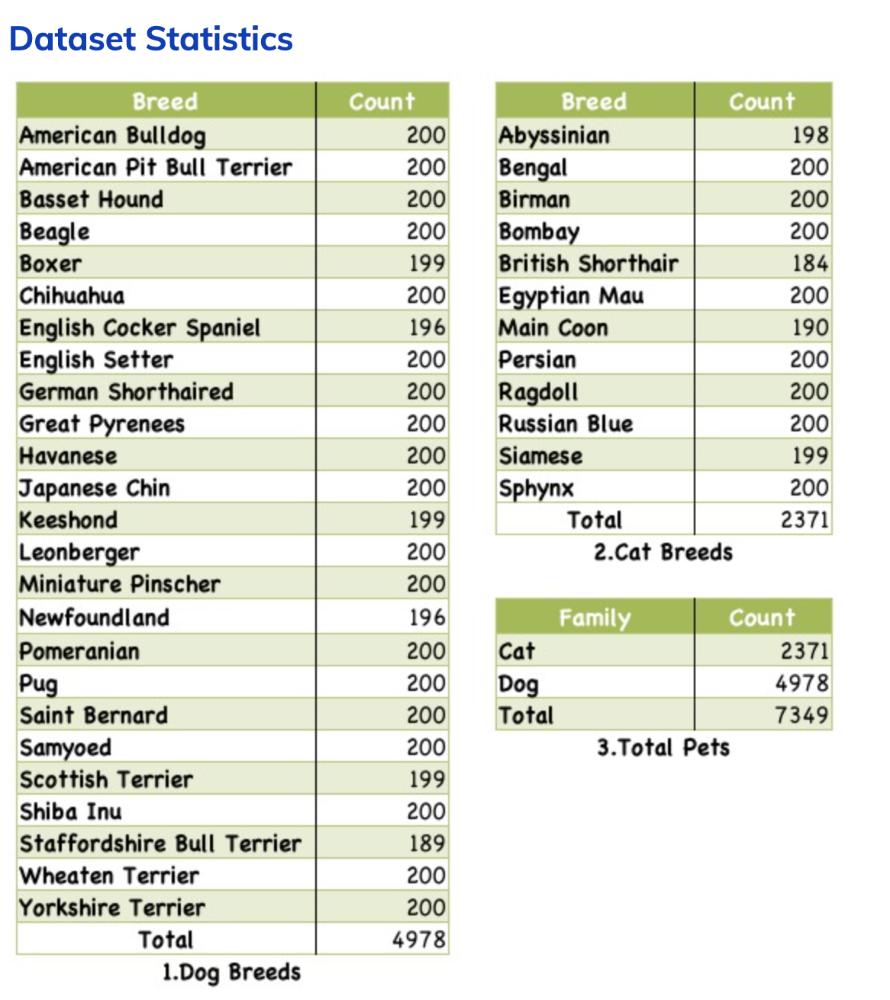

### Type of pre fetched dataset loaded

In [ ]:
type(oxford_iiit_pet_dataset)

dict

In [ ]:
# It consist train and test dataset as unique identity records.
oxford_iiit_pet_dataset.keys()

dict_keys(['train', 'test'])

In [ ]:
# It consist train and test dataset as unique identity records.
for k,v in oxford_iiit_pet_dataset.items():
  print("#"*10,k,"#"*10)
  print(oxford_iiit_pet_dataset[k])

########## train ##########
<PrefetchDataset element_spec={'file_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'image': TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), 'label': TensorSpec(shape=(), dtype=tf.int64, name=None), 'segmentation_mask': TensorSpec(shape=(None, None, 1), dtype=tf.uint8, name=None), 'species': TensorSpec(shape=(), dtype=tf.int64, name=None)}>
########## test ##########
<PrefetchDataset element_spec={'file_name': TensorSpec(shape=(), dtype=tf.string, name=None), 'image': TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), 'label': TensorSpec(shape=(), dtype=tf.int64, name=None), 'segmentation_mask': TensorSpec(shape=(None, None, 1), dtype=tf.uint8, name=None), 'species': TensorSpec(shape=(), dtype=tf.int64, name=None)}>


In [ ]:
# To display the list of images with their mask
def display(display_list):
  plt.figure(figsize=(15, 15))
  title = ["Input Image", "True Mask", "Predicted Mask"]
  for i in range(len(display_list)):
    plt.subplot(1, len(display_list), i+1)
    plt.title(title[i])
    plt.imshow(tf.keras.utils.array_to_img(display_list[i]))
    plt.axis("off")
  plt.show()



Random Sample size of image:  (500, 372, 3)


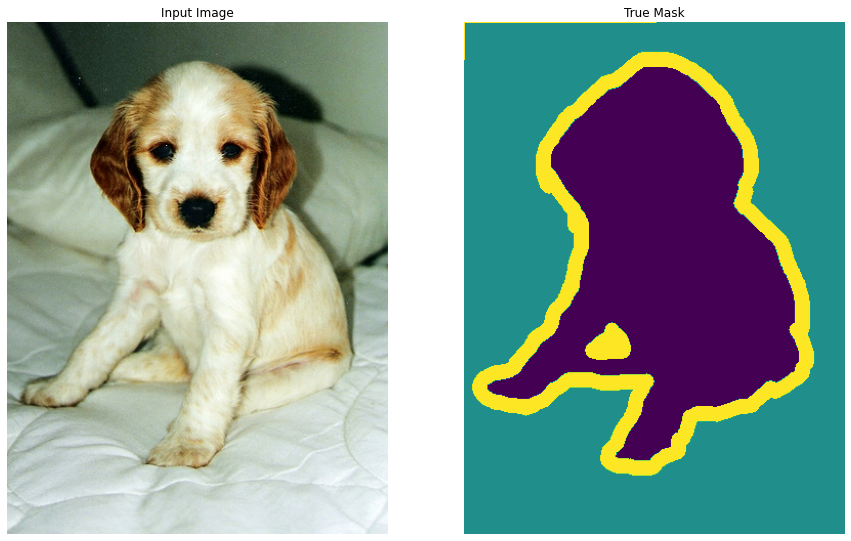



Random Sample size of image:  (900, 600, 3)


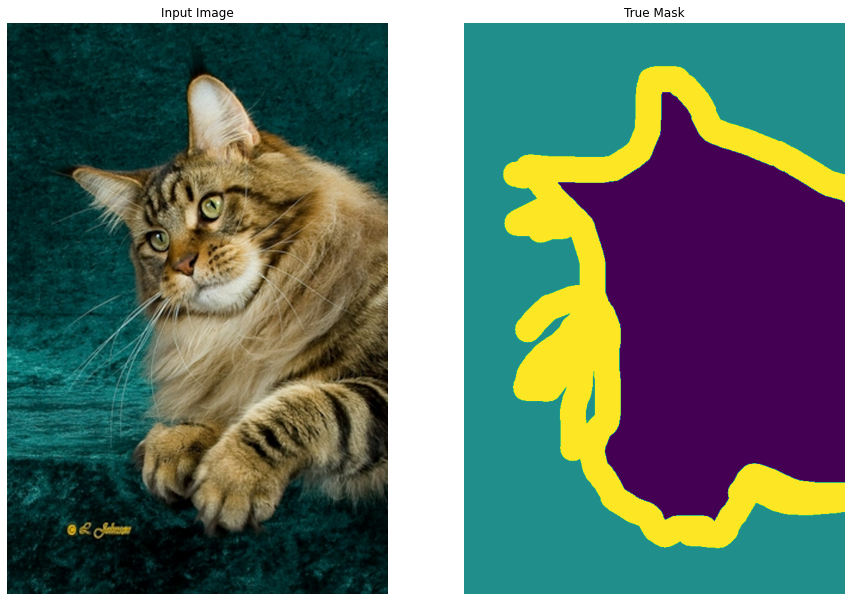



Random Sample size of image:  (180, 240, 3)


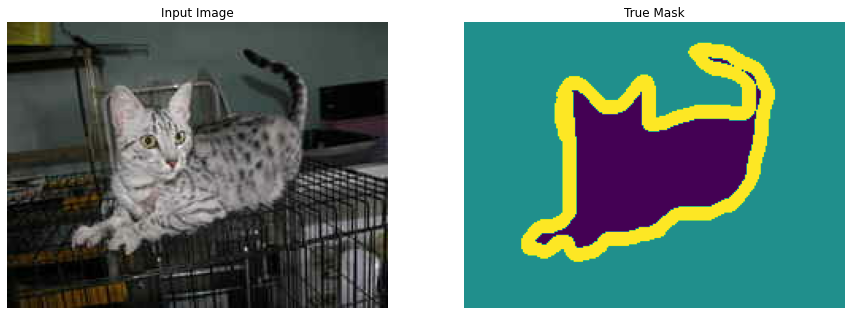



Random Sample size of image:  (300, 200, 3)


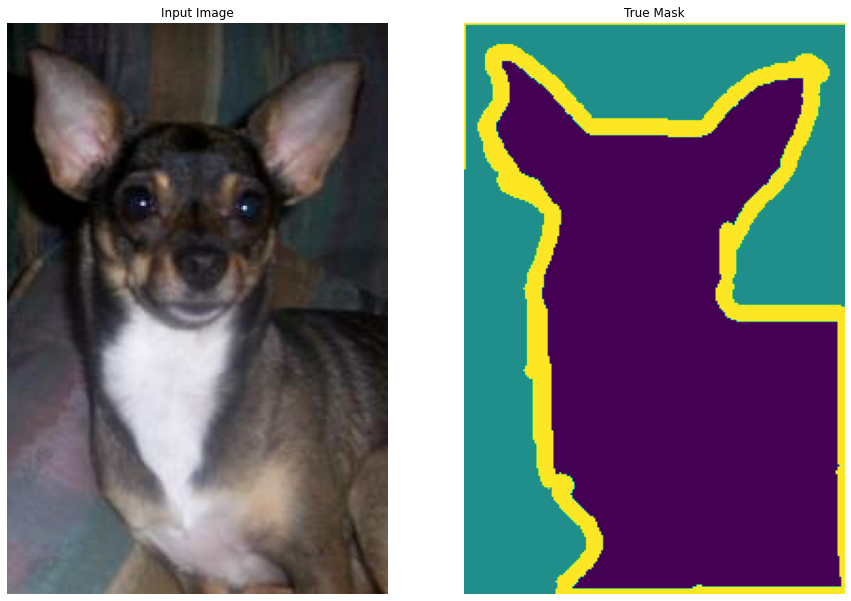



Random Sample size of image:  (479, 500, 3)


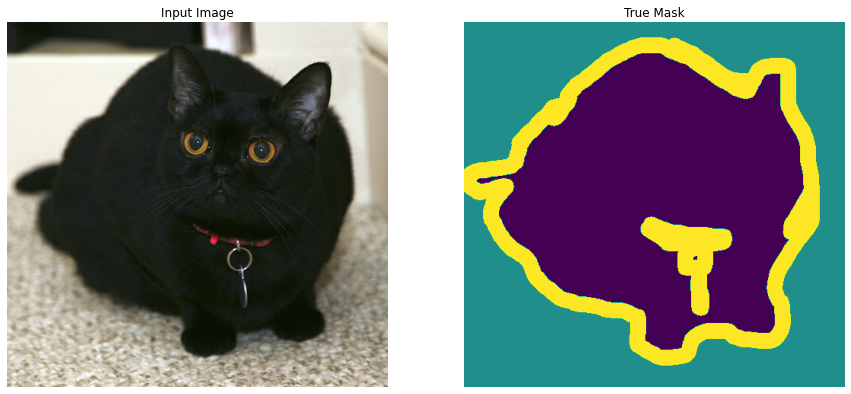

In [ ]:
# Distribution of shape in original train dataset
dim1 = []
dim2 = []
first_5_view = oxford_iiit_pet_dataset['train'].take(3680)
# Plot random 5 images from the full dataset
for sample in oxford_iiit_pet_dataset['train'].shuffle(buffer_size=100).take(5):
      print("\n\nRandom Sample size of image: ",sample['image'].shape)
      display([sample['image'],sample['segmentation_mask']])
for input_image in first_5_view:    
  dim1.append(input_image['image'].shape[0])
  dim2.append(input_image['image'].shape[1])

With 3 color channels the height list length is:  3680
With 3 color channels the width list length is:  3680
Mean across height of all images in train set is: 383.4203804347826
Mean across width of all images in train set is: 431.03342391304346


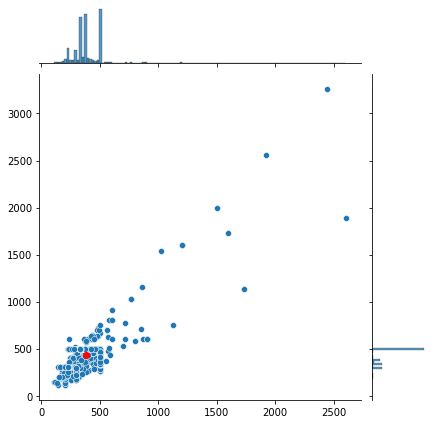

In [ ]:
print("With 3 color channels the height list length is: ",len(dim1))
print("With 3 color channels the width list length is: ",len(dim2))
print("Mean across height of all images in train set is:",np.mean(dim1))
print("Mean across width of all images in train set is:",np.mean(dim2))
# Here we can observe the most of the images are around the mean value
sns.jointplot(x=dim1, y=dim2)
plt.scatter(np.mean(dim1),np.mean(dim2),color='r')
# plt.axis("off")

In [ ]:
# using nearest neighbor interpolation for resizing of images to 128 by 128
def resize(input_image, input_mask):
    input_image = tf.image.resize(input_image, (128, 128), method="nearest")
    input_mask = tf.image.resize(input_mask, (128, 128), method="nearest")
    return input_image, input_mask 

# Augmentation of images with random horizontal flip is done
def augment(input_image, input_mask):
    if tf.random.uniform(()) > 0.5:
        # Random flipping of the image and mask
        input_image = tf.image.flip_left_right(input_image)
        input_mask = tf.image.flip_left_right(input_mask)
    return input_image, input_mask

# In addition, the image color values are normalized to the [0, 1] range. 
# Finally, as mentioned above the pixels in the segmentation mask are labeled either {1, 2, 3}. 
# For the sake of convenience, subtract 1 from the segmentation mask, resulting in labels that are : {0, 1, 2}.
def normalize(input_image, input_mask):
    input_image = tf.cast(input_image, tf.float32) / 255.0
    input_mask -= 1
    return input_image, input_mask


# There are two functions to preprocess the training and test datasets with a difference that between the two – we only perform image augmentation on the training dataset.
def load_dataset_train(datapoint):
  input_image = datapoint["image"]
  input_mask = datapoint["segmentation_mask"]
  input_image, input_mask = resize(input_image, input_mask)
  input_image, input_mask = augment(input_image, input_mask)
  input_image, input_mask = normalize(input_image, input_mask)
  return input_image, input_mask

def load_dataset_test(datapoint):
  input_image = datapoint["image"]
  input_mask = datapoint["segmentation_mask"]
  input_image, input_mask = resize(input_image, input_mask)
  input_image, input_mask = normalize(input_image, input_mask)
  return input_image, input_mask

In [ ]:
train_dataset = oxford_iiit_pet_dataset["train"].map(load_dataset_train ,num_parallel_calls=tf.data.AUTOTUNE)
test_dataset = oxford_iiit_pet_dataset["test"].map(load_dataset_test, num_parallel_calls=tf.data.AUTOTUNE)

In [ ]:
print(type(train_dataset))
print(train_dataset)
print(test_dataset)

<class 'tensorflow.python.data.ops.dataset_ops.ParallelMapDataset'>
<ParallelMapDataset element_spec=(TensorSpec(shape=(128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(128, 128, 1), dtype=tf.uint8, name=None))>
<ParallelMapDataset element_spec=(TensorSpec(shape=(128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(128, 128, 1), dtype=tf.uint8, name=None))>


In [ ]:
# configuration for splitting of dataset and nuber of epochs training will happen
BATCH_SIZE = 64
NUM_EPOCHS = 100
BUFFER_SIZE = 1000
VAL_SUBSPLITS = 5

TRAIN_LENGTH = info.splits['train'].num_examples
TEST_LENGTH = info.splits['test'].num_examples
STEPS_PER_EPOCH = TRAIN_LENGTH // BATCH_SIZE

print("Train shape and steps per epoch for which training will happen:", TRAIN_LENGTH,STEPS_PER_EPOCH)
print("Test Shape", TEST_LENGTH)

TRAIN_LENGTH = info.splits["train"].num_examples
VALIDATION_STEPS = TEST_LENGTH // BATCH_SIZE // VAL_SUBSPLITS

Train shape and steps per epoch for which training will happen: 3680 57
Test Shape 3669


In [ ]:
# use full train dataset
train_batches = train_dataset.cache().shuffle(BUFFER_SIZE).batch(BATCH_SIZE).repeat()
train_batches = train_batches.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

# use validation dataset from test dataset 
validation_batches = test_dataset.take(3000).batch(BATCH_SIZE)

# use test dataset
test_batches = test_dataset.skip(3000).take(669).batch(BATCH_SIZE)

In [ ]:
# shape_dataset = train_batches.reduce(0, lambda x, _: x + 1)
# print(shape_dataset)

In [ ]:
# For validation if resizing happens of first 5 batches in train
first_5_view = train_batches.take(5)
for input_image,input_mask in first_5_view:
  print(input_image.shape,input_mask.shape)

(64, 128, 128, 3) (64, 128, 128, 1)
(64, 128, 128, 3) (64, 128, 128, 1)
(64, 128, 128, 3) (64, 128, 128, 1)
(64, 128, 128, 3) (64, 128, 128, 1)
(64, 128, 128, 3) (64, 128, 128, 1)


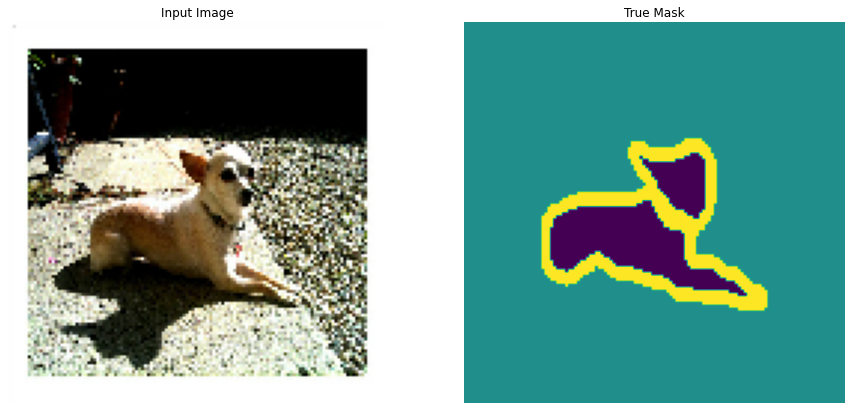

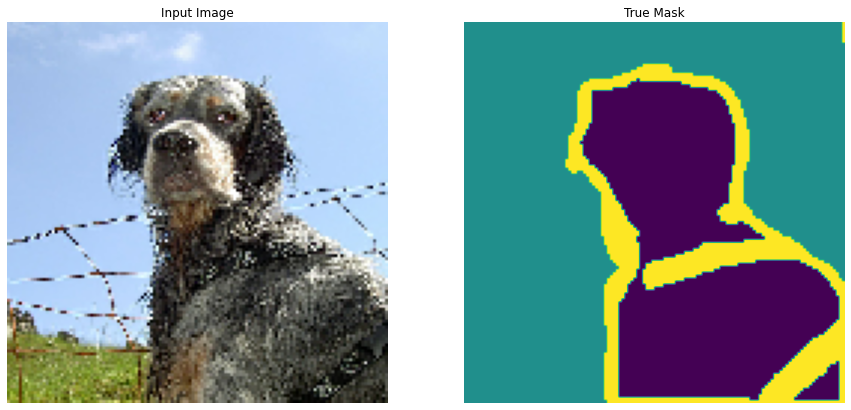

In [ ]:
# Visualisation after preprocessing of train and test images, we can see the clear resizing in pixels

# test image visualisation
sample_batch = next(iter(test_batches))
random_index = np.random.choice(sample_batch[0].shape[0])
sample_image, sample_mask = sample_batch[0][random_index], sample_batch[1][random_index]
display([sample_image, sample_mask])

# train image visualisation
sample_batch = next(iter(train_batches))
random_index = np.random.choice(sample_batch[0].shape[0])
sample_image, sample_mask = sample_batch[0][random_index], sample_batch[1][random_index]
display([sample_image, sample_mask])

## Unet Architecture flow:

In [ ]:
def double_conv_block(x, n_filters):
    # Conv2D then ReLU activation
    x = layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
    # Conv2D then ReLU activation
    x = layers.Conv2D(n_filters, 3, padding = "same", activation = "relu", kernel_initializer = "he_normal")(x)
    return x

def downsample_block(x, n_filters):
    start = double_conv_block(x, n_filters)
    end = layers.MaxPool2D(2)(start)
    end = layers.Dropout(0.3)(end)
    return start, end

def upsample_block(x, conv_features, n_filters):
    # upsample
    x = layers.Conv2DTranspose(n_filters, 3, 2, padding="same")(x)
    # concatenate 
    x = layers.concatenate([x, conv_features])
    # dropout
    x = layers.Dropout(0.3)(x)
    # Conv2D twice with ReLU activation
    x = double_conv_block(x, n_filters)
    return x

In [ ]:
def unet_model_architecture():
    filters = [64,64*2,64*2*2,64*2*2*2]
    
    # input layer
    inputs = layers.Input(shape=(128,128,3))
    x = inputs
    
    skip_list = []
    # encoder: contracting path - downsample
    for _f in filters:
      f1, x = downsample_block(x, _f)
      skip_list.append(f1)
    
    # bottleneck layer
    bottleneck = double_conv_block(x, 1024)

    # decoder: expanding path - upsample
    for _f,_skp in zip(filters[::-1],skip_list[::-1]):
      bottleneck = upsample_block(bottleneck,_skp ,_f)

    # outputs has 3 classes that's why the final layer will have 3 output classes for this multiclassification problem
    outputs = layers.Conv2D(3, 1, padding="same", activation = "softmax")(bottleneck)

    # unet model with Keras Functional API
    unet_model = tf.keras.Model(inputs, outputs, name="U-Net")

    return unet_model

In [ ]:
unet_model = unet_model_architecture()

In [ ]:
unet_model.summary()

Model: "U-Net"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 128, 128, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 128, 128, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 128, 128, 64  36928       ['conv2d[0][0]']                 
                                )                                                             

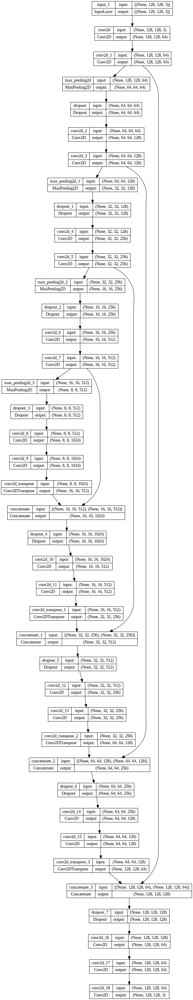

In [ ]:
plot_model(unet_model, show_shapes=True)

In [ ]:
# Define a function to return a commmonly used callback_list
def def_callbacks(filepath, mod_chk_mon = "val_loss", tensorboard = True, earlystop = 0):
    callback_list = []

    # Defualt callback
    callback_list.append(ModelCheckpoint(filepath,
                                         save_best_only = True,
                                         monitor=mod_chk_mon))
    if tensorboard:
      log_dir = "tensorLog_" + filepath
      callback_list.append(TensorBoard(log_dir=log_dir))

    if earlystop>0:
       callback_list.append(EarlyStopping(patience=earlystop))
    return callback_list

In [ ]:
# Considering the equal weights for 3 classes
unet_model.compile(optimizer=tf.keras.optimizers.Adam(),
                   loss="sparse_categorical_crossentropy",
                   metrics="accuracy"
                   )
# try:
#   model_history = model.fit(train_batches, epochs=EPOCHS,
#                             steps_per_epoch=STEPS_PER_EPOCH,
#                             )
#   assert False
# except Exception as e:
#   print(f"Expected {type(e).__name__}: {e}")

## Training the mode. Used multi processing and early stopping as 10 to finish the training with optimal time which is around 40-50 minutes

In [ ]:
model_history = unet_model.fit(train_batches,
                               epochs=NUM_EPOCHS,
                               steps_per_epoch=STEPS_PER_EPOCH,
                               validation_steps=VALIDATION_STEPS,
                               validation_data=validation_batches,
                               callbacks=def_callbacks(filepath = "unet_from_scratch_with_augmentation_keras",
                                            mod_chk_mon = 'val_loss', earlystop = 10),
                               verbose=1, use_multiprocessing=True
                               #  class_weight = {0:2.0, 1:2.0, 2:1.0}
                               )

Epoch 1/100
57/57 [==============================] - ETA: 0s - loss: 0.9205 - accuracy: 0.5799

57/57 [==============================] - 102s 1s/step - loss: 0.9205 - accuracy: 0.5799 - val_loss: 0.8697 - val_accuracy: 0.5753
Epoch 2/100
57/57 [==============================] - ETA: 0s - loss: 0.7922 - accuracy: 0.6295

57/57 [==============================] - 70s 1s/step - loss: 0.7922 - accuracy: 0.6295 - val_loss: 0.7682 - val_accuracy: 0.6447
Epoch 3/100
57/57 [==============================] - ETA: 0s - loss: 0.6649 - accuracy: 0.7263

57/57 [==============================] - 62s 1s/step - loss: 0.6649 - accuracy: 0.7263 - val_loss: 0.6623 - val_accuracy: 0.7295
Epoch 4/100
57/57 [==============================] - ETA: 0s - loss: 0.6089 - accuracy: 0.7576

57/57 [==============================] - 66s 1s/step - loss: 0.6089 - accuracy: 0.7576 - val_loss: 0.5688 - val_accuracy: 0.7760
Epoch 5/100
57/57 [==============================] - ETA: 0s - loss: 0.5342 - accuracy: 0.7896

57/57 [==============================] - 64s 1s/step - loss: 0.5342 - accuracy: 0.7896 - val_loss: 0.4876 - val_accuracy: 0.8073
Epoch 6/100
57/57 [==============================] - 60s 1s/step - loss: 0.4856 - accuracy: 0.8107 - val_loss: 0.5277 - val_accuracy: 0.7952
Epoch 7/100
57/57 [==============================] - ETA: 0s - loss: 0.4568 - accuracy: 0.8235

57/57 [==============================] - 72s 1s/step - loss: 0.4568 - accuracy: 0.8235 - val_loss: 0.4410 - val_accuracy: 0.8307
Epoch 8/100
57/57 [==============================] - ETA: 0s - loss: 0.4272 - accuracy: 0.8361

57/57 [==============================] - 68s 1s/step - loss: 0.4272 - accuracy: 0.8361 - val_loss: 0.4041 - val_accuracy: 0.8442
Epoch 9/100
57/57 [==============================] - 60s 1s/step - loss: 0.3975 - accuracy: 0.8474 - val_loss: 0.4064 - val_accuracy: 0.8432
Epoch 10/100
57/57 [==============================] - ETA: 0s - loss: 0.3854 - accuracy: 0.8522

57/57 [==============================] - 64s 1s/step - loss: 0.3854 - accuracy: 0.8522 - val_loss: 0.3788 - val_accuracy: 0.8586
Epoch 11/100
57/57 [==============================] - 58s 1s/step - loss: 0.3613 - accuracy: 0.8608 - val_loss: 0.4233 - val_accuracy: 0.8412
Epoch 12/100
57/57 [==============================] - ETA: 0s - loss: 0.3509 - accuracy: 0.8646

57/57 [==============================] - 63s 1s/step - loss: 0.3509 - accuracy: 0.8646 - val_loss: 0.3568 - val_accuracy: 0.8658
Epoch 13/100
57/57 [==============================] - 58s 1s/step - loss: 0.3320 - accuracy: 0.8726 - val_loss: 0.3578 - val_accuracy: 0.8689
Epoch 14/100
57/57 [==============================] - 58s 1s/step - loss: 0.3229 - accuracy: 0.8757 - val_loss: 0.3657 - val_accuracy: 0.8617
Epoch 15/100
57/57 [==============================] - ETA: 0s - loss: 0.3153 - accuracy: 0.8786

57/57 [==============================] - 63s 1s/step - loss: 0.3153 - accuracy: 0.8786 - val_loss: 0.3375 - val_accuracy: 0.8747
Epoch 16/100
57/57 [==============================] - 58s 1s/step - loss: 0.3134 - accuracy: 0.8786 - val_loss: 0.3469 - val_accuracy: 0.8672
Epoch 17/100
57/57 [==============================] - 58s 1s/step - loss: 0.2957 - accuracy: 0.8859 - val_loss: 0.3379 - val_accuracy: 0.8741
Epoch 18/100
57/57 [==============================] - ETA: 0s - loss: 0.2926 - accuracy: 0.8869

57/57 [==============================] - 66s 1s/step - loss: 0.2926 - accuracy: 0.8869 - val_loss: 0.3169 - val_accuracy: 0.8816
Epoch 19/100
57/57 [==============================] - 58s 1s/step - loss: 0.2869 - accuracy: 0.8888 - val_loss: 0.3184 - val_accuracy: 0.8845
Epoch 20/100
57/57 [==============================] - 58s 1s/step - loss: 0.2775 - accuracy: 0.8929 - val_loss: 0.3246 - val_accuracy: 0.8806
Epoch 21/100
57/57 [==============================] - ETA: 0s - loss: 0.2621 - accuracy: 0.8988

57/57 [==============================] - 64s 1s/step - loss: 0.2621 - accuracy: 0.8988 - val_loss: 0.3050 - val_accuracy: 0.8871
Epoch 22/100
57/57 [==============================] - 58s 1s/step - loss: 0.2731 - accuracy: 0.8945 - val_loss: 0.3308 - val_accuracy: 0.8789
Epoch 23/100
57/57 [==============================] - 58s 1s/step - loss: 0.2567 - accuracy: 0.9003 - val_loss: 0.3076 - val_accuracy: 0.8893
Epoch 24/100
57/57 [==============================] - 58s 1s/step - loss: 0.2435 - accuracy: 0.9047 - val_loss: 0.3365 - val_accuracy: 0.8807
Epoch 25/100
57/57 [==============================] - 60s 1s/step - loss: 0.2484 - accuracy: 0.9036 - val_loss: 0.3226 - val_accuracy: 0.8852
Epoch 26/100
57/57 [==============================] - 58s 1s/step - loss: 0.2369 - accuracy: 0.9075 - val_loss: 0.3266 - val_accuracy: 0.8874
Epoch 27/100
57/57 [==============================] - 58s 1s/step - loss: 0.2343 - accuracy: 0.9087 - val_loss: 0.3101 - val_accuracy: 0.8902
Epoch 28/100
57/57 

# Plot training health metrics - validation loss vs number of epochs and accuracy vs number of epochs

In [ ]:
def display_learning_curves(history):
    acc = history.history["accuracy"]
    val_acc = history.history["val_accuracy"]

    loss = history.history["loss"]
    val_loss = history.history["val_loss"]

    # early stopping needs history length 
    epochs_range = range(len(history.history["val_loss"]))

    fig = plt.figure(figsize=(12,6))

    plt.subplot(1,2,1)
    plt.plot(epochs_range, acc, label="train accuracy")
    plt.plot(epochs_range, val_acc, label="validataion accuracy")
    plt.title("Accuracy")
    plt.xlabel("Epoch")
    plt.ylabel("Accuracy")
    plt.legend(loc="lower right")

    plt.subplot(1,2,2)
    plt.plot(epochs_range, loss, label="train loss")
    plt.plot(epochs_range, val_loss, label="validataion loss")
    plt.title("Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend(loc="upper right")

    fig.tight_layout()
    plt.show()

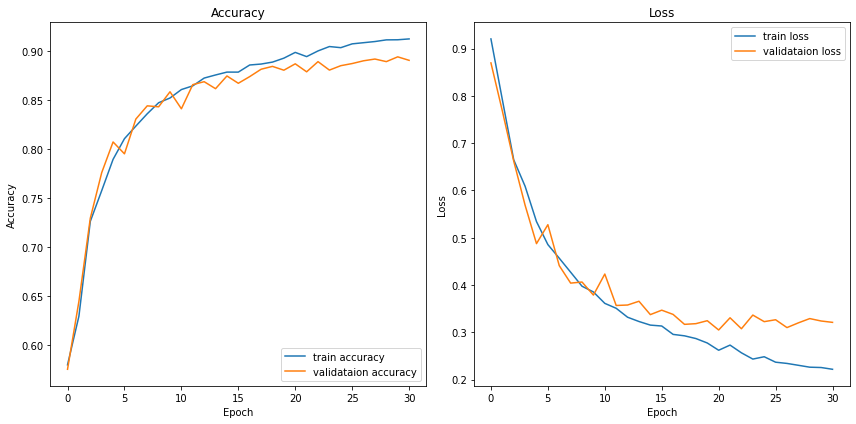

In [ ]:
# Display learning curves 
display_learning_curves(unet_model.history)

In [ ]:
def create_mask(pred_mask):
  pred_mask = tf.argmax(pred_mask, axis=-1)
  pred_mask = pred_mask[..., tf.newaxis]
  return pred_mask[0]

def show_predictions(dataset=None,model_name=None, num=1):
  if dataset:
    for image, mask in dataset.take(num):
      pred_mask = model_name.predict(image)
      display([image[0], mask[0], create_mask(pred_mask)])
  else:
    display([sample_image, sample_mask,
             create_mask(model_name.predict(sample_image[tf.newaxis, ...]))])

count = 0
for i in test_batches:
    count +=1
print("number of batches:", count)

number of batches: 11


2/2 [==============================] - 0s 181ms/step


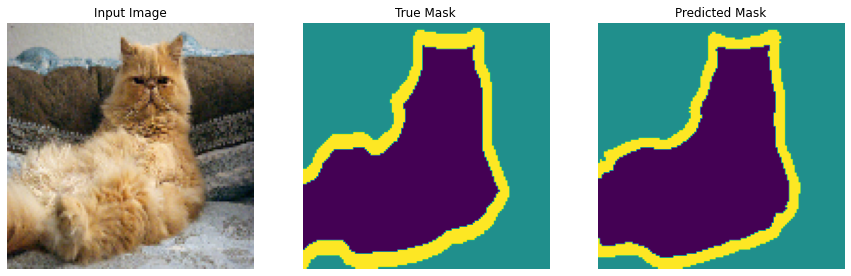

2/2 [==============================] - 0s 133ms/step


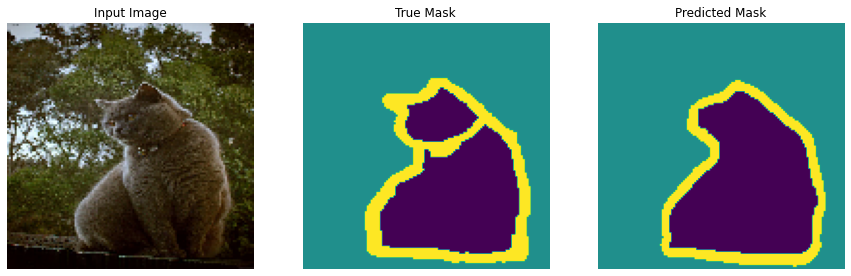

2/2 [==============================] - 0s 122ms/step


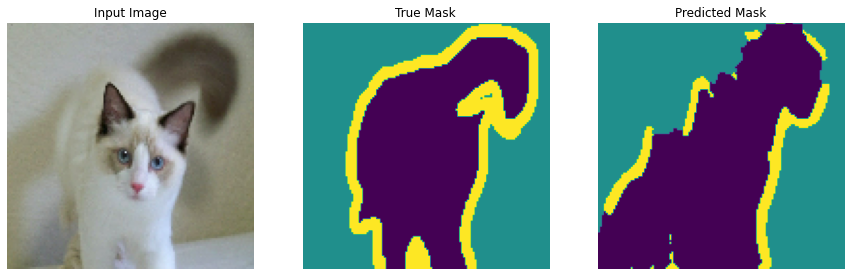

2/2 [==============================] - 0s 128ms/step


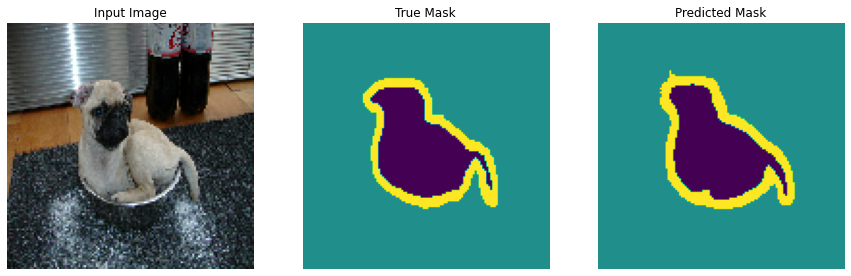

2/2 [==============================] - 0s 123ms/step


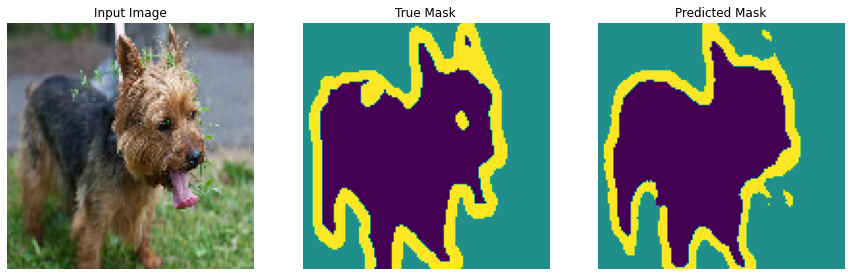

In [ ]:
show_predictions(test_batches.skip(1),unet_model, 5)

## For below example for shadow subject, the segmentation was not proper which means we can improve it by sharpening the image and using auto contrast pre processing

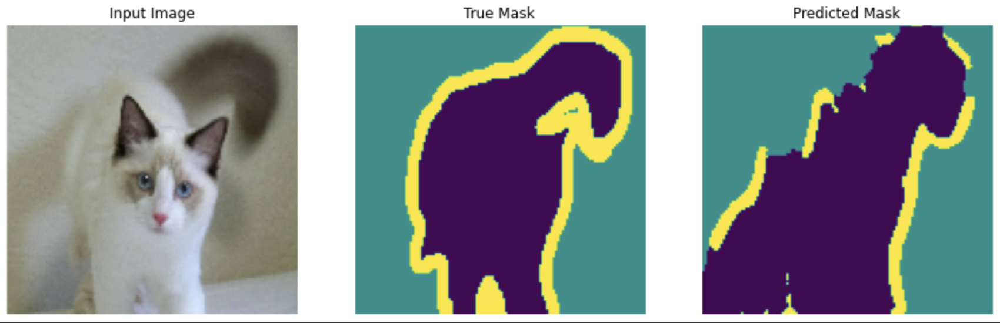

## For below examples we can observe the minute details are not captured by u-net, it could be because of huge pixel loss after resizing. We can think of use the mean resolution across train images which is around 380x380

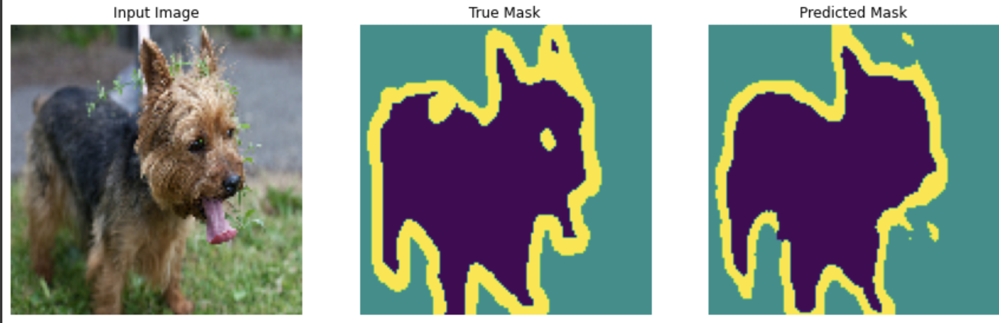

In [ ]:
for i in test_batches:
    print("Input Test images: ",i[0].shape,"\nActual Test mask: ",i[1].shape)
    break

Input Test images:  (64, 128, 128, 3) 
Actual Test mask:  (64, 128, 128, 1)


In [ ]:
# Loading the best saved model via checkpoint to access the saved model
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
os.listdir('/content/drive/MyDrive/Unet_Model/')

['keras_metadata.pb',
 'saved_model.pb',
 'unet_model.h5',
 'variables',
 '.ipynb_checkpoints',
 'fingerprint.pb']

## Load the full trained model till the patience 10 reached

In [ ]:
# unet_model.load_weights('/content/drive/MyDrive/Unet_Model')
unet_model = keras.models.load_model('/content/drive/MyDrive/Unet_Model/unet_model.h5')
# unet_model.save('/content/drive/MyDrive/Unet_Model/unet_model_pretrained.h5')
# os.listdir('/content/drive/MyDrive/pre_trained_weights/unet_from_scratch_with_augmentation_keras')

# unet_model.save('unet_model.h5')
# unet_model = keras.models.load_model('/content/drive/MyDrive/Unet_Model/unet_model.h5')

## Load the model based on minimum loss in above training

In [ ]:
unet_best_model = keras.models.load_model("/content/drive/MyDrive/Unet_Model") 

number of batches: 11
2/2 [==============================] - 12s 11ms/step


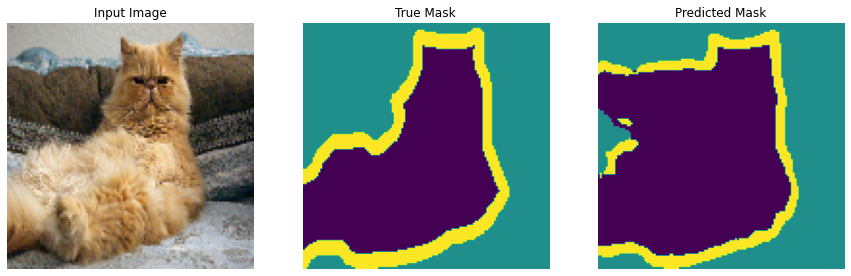

2/2 [==============================] - 0s 121ms/step


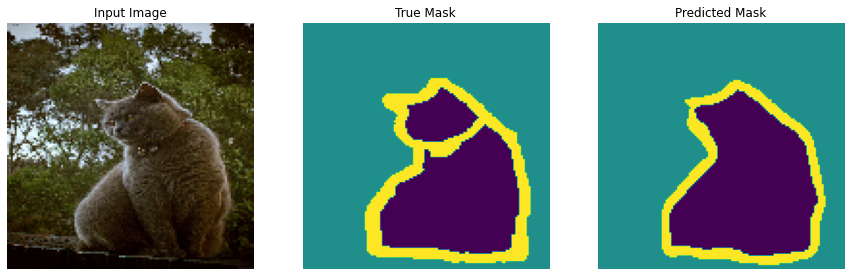

2/2 [==============================] - 0s 131ms/step


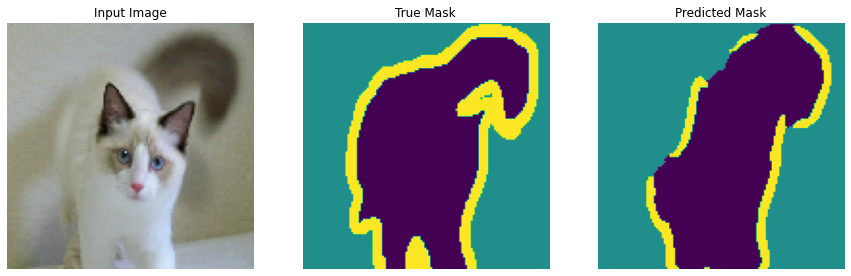

2/2 [==============================] - 0s 125ms/step


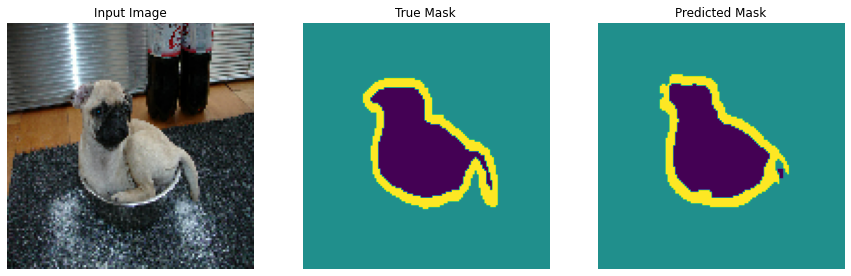

2/2 [==============================] - 0s 123ms/step


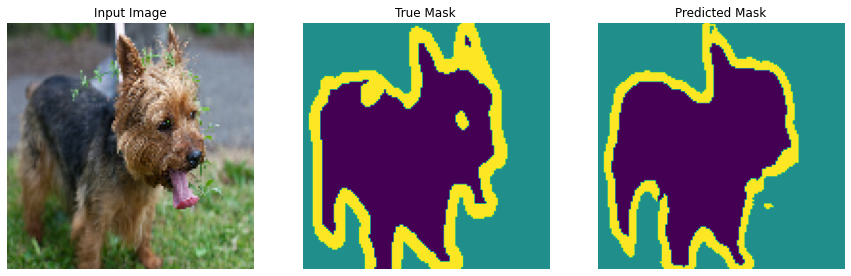

In [ ]:
count = 0
for i in test_batches:
    count +=1
print("number of batches:", count)
show_predictions(test_batches.skip(1),unet_best_model, 5)

## Test Loss and Test accuracy evaluation on best model and final model

In [ ]:
unet_best_model.evaluate(test_batches)

11/11 [==============================] - 22s 550ms/step - loss: 0.3003 - accuracy: 0.8878


[0.30031049251556396, 0.8878374695777893]

In [ ]:
unet_model.evaluate(test_batches)

11/11 [==============================] - 14s 258ms/step - loss: 0.2940 - accuracy: 0.8974


[0.2940448522567749, 0.8974108695983887]

## So, the model trained till the end is performing better on test data than the best saved model based on patience as 10.

## Classification evaluation metrics for all classes

In [ ]:
y_pred = unet_model.predict(test_batches)

11/11 [==============================] - 14s 313ms/step


In [ ]:
test_batches

<BatchDataset element_spec=(TensorSpec(shape=(None, 128, 128, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 128, 128, 1), dtype=tf.uint8, name=None))>

In [ ]:
y_pred.shape

(669, 128, 128, 3)

## For 669 images in total of test images below is the prediction

In [ ]:
for image, mask in test_batches.take(11):
  print(image.shape)

(64, 128, 128, 3)
(64, 128, 128, 3)
(64, 128, 128, 3)
(64, 128, 128, 3)
(64, 128, 128, 3)
(64, 128, 128, 3)
(64, 128, 128, 3)
(64, 128, 128, 3)
(64, 128, 128, 3)
(64, 128, 128, 3)
(29, 128, 128, 3)


In [ ]:
image[0].shape

TensorShape([128, 128, 3])

In [ ]:
def create_mask(pred_mask):
  pred_mask = tf.argmax(pred_mask, axis=-1)
  pred_mask = pred_mask[..., tf.newaxis]
  return pred_mask[0]

def show_predictions(dataset=None, num=1):
  if dataset:
    for image, mask in dataset.take(num):
      pred_mask = unet_model.predict(image)
      display([image[0], mask[0], create_mask(pred_mask)])
  else:
    display([sample_image, sample_mask,
             create_mask(unet_model.predict(sample_image[tf.newaxis, ...]))])

In [ ]:
show_predictions(test_batches, 669)

2/2 [==============================] - 0s 196ms/step


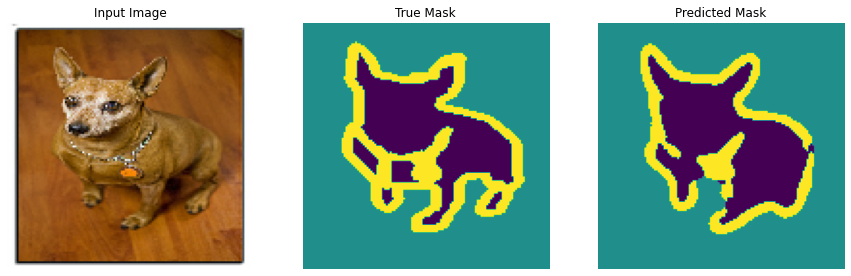

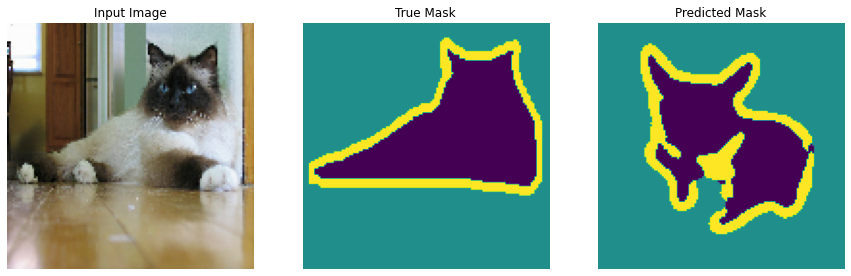

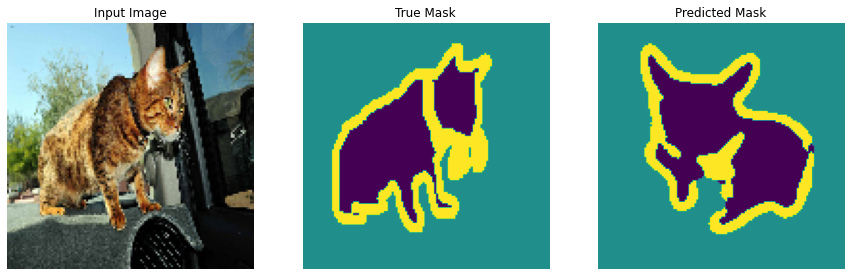

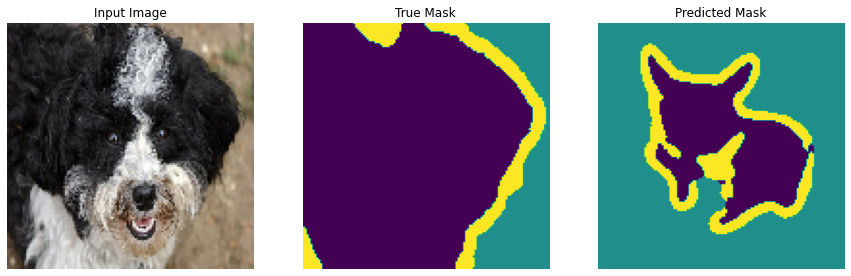

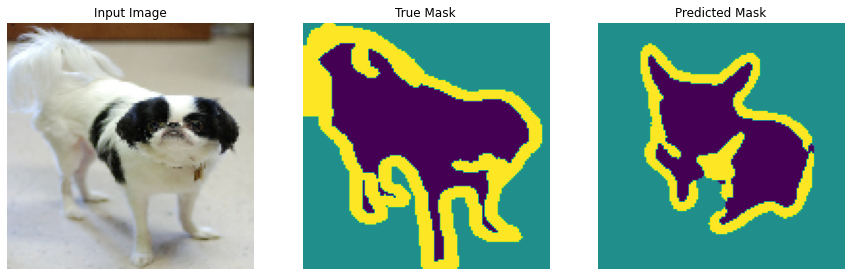

...

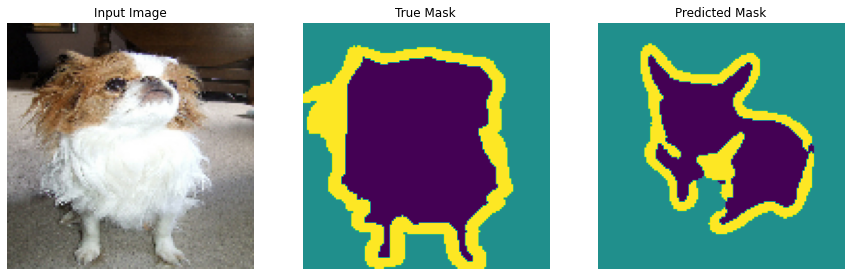

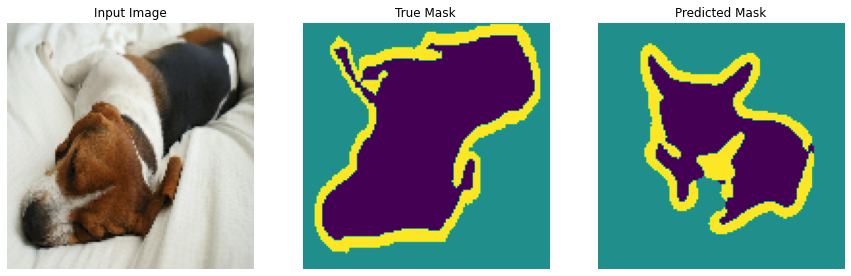

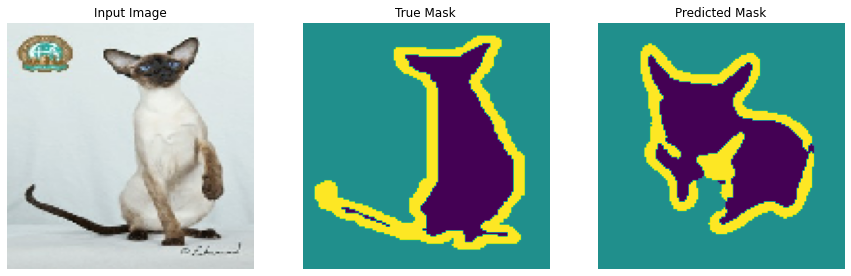

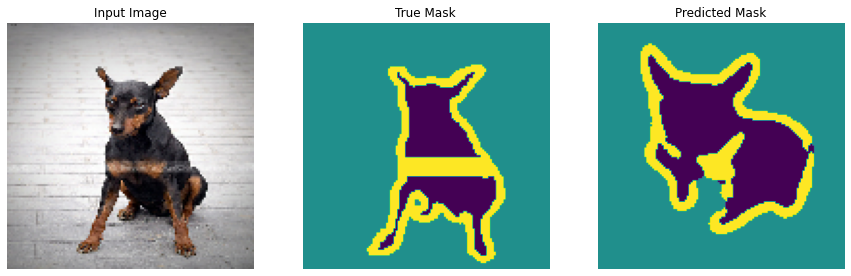

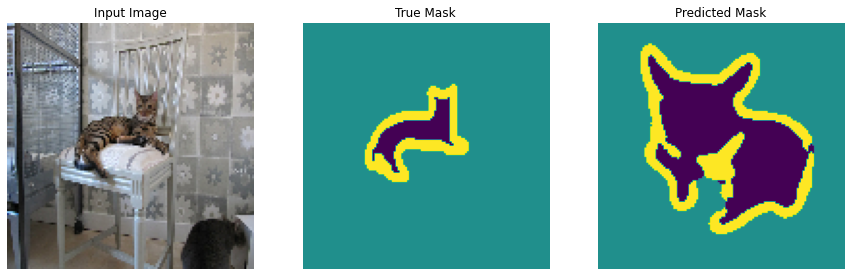

2/2 [==============================] - 0s 187ms/step


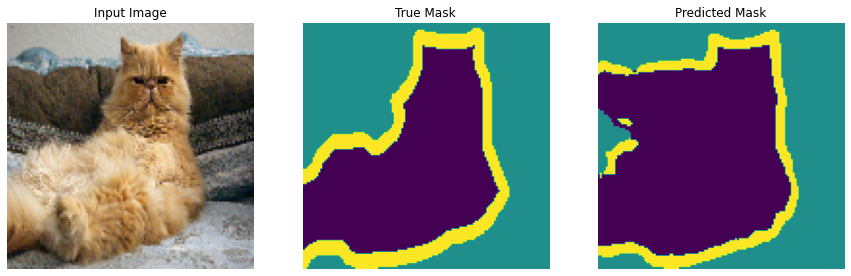

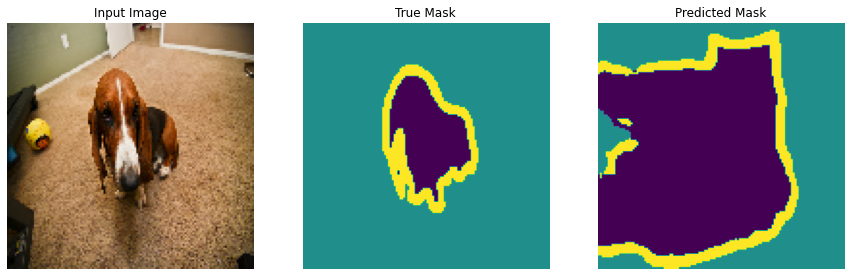

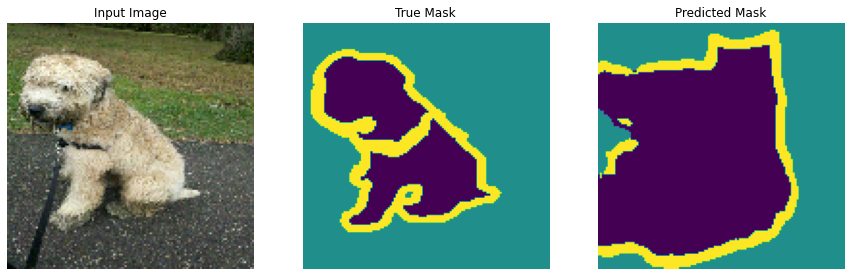

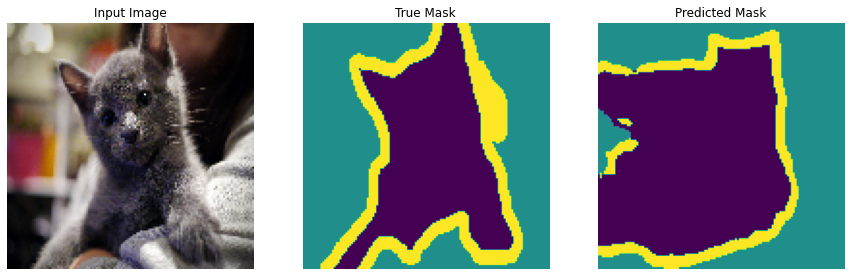

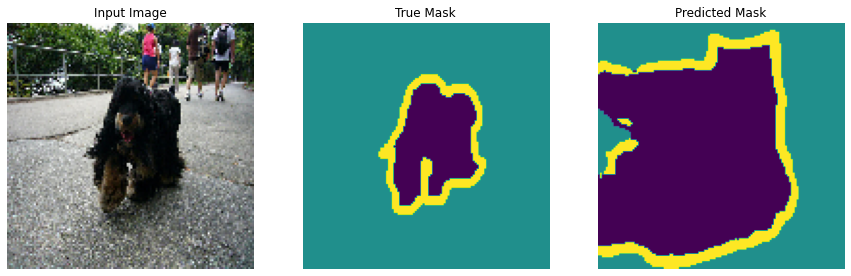

...

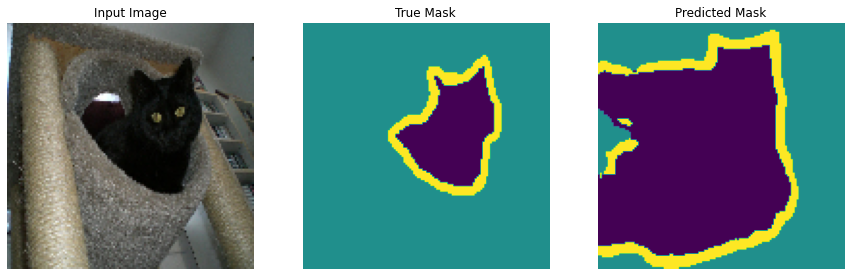

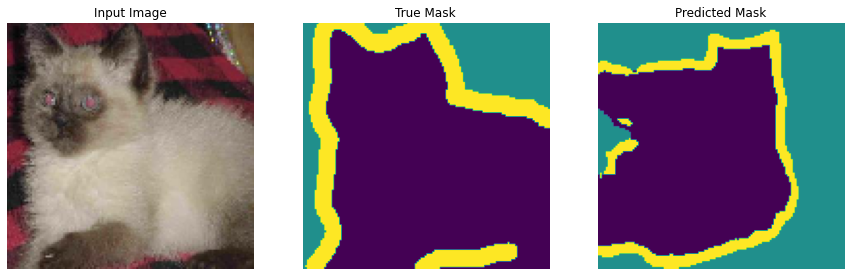

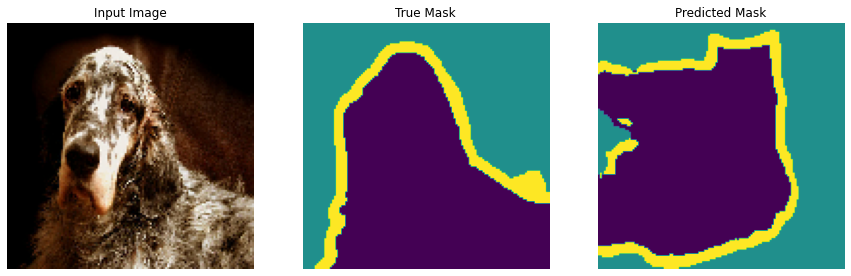

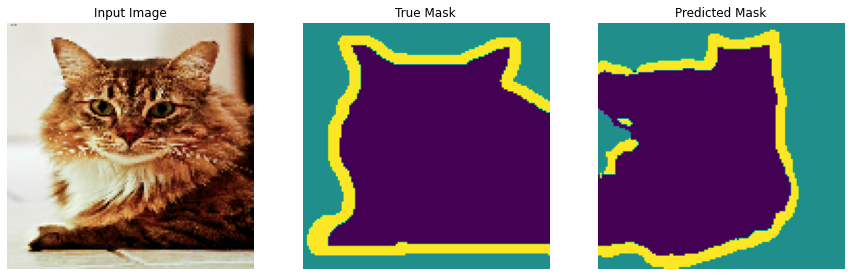

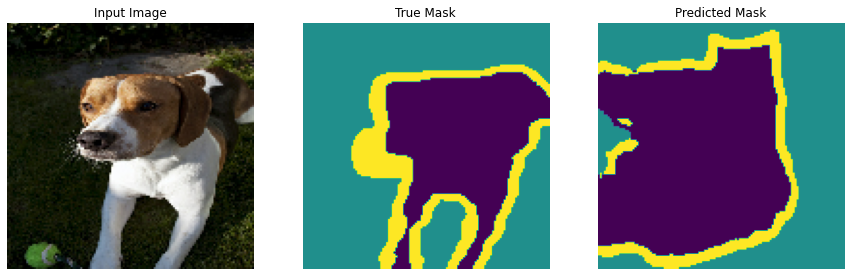

2/2 [==============================] - 0s 194ms/step


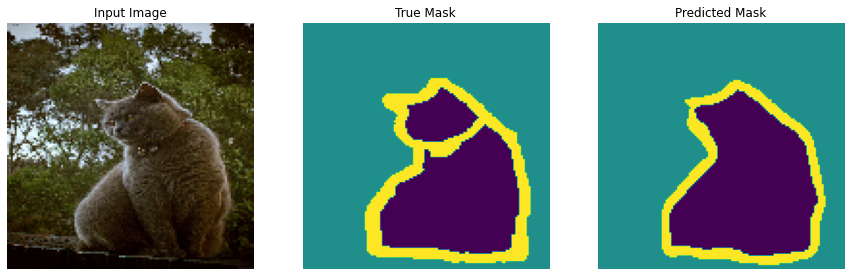

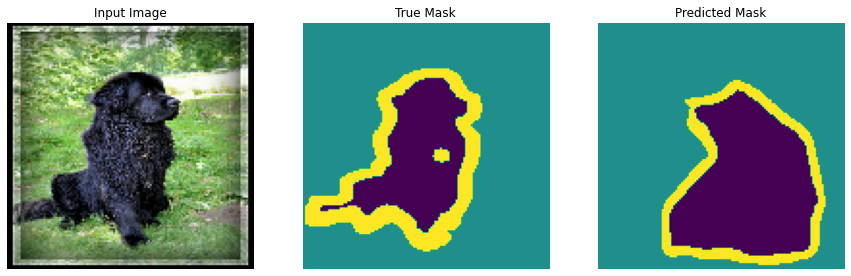

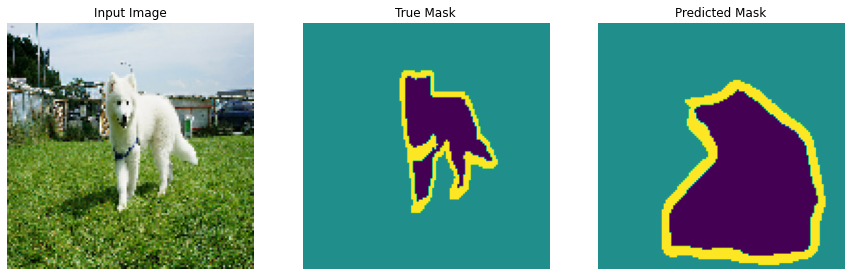

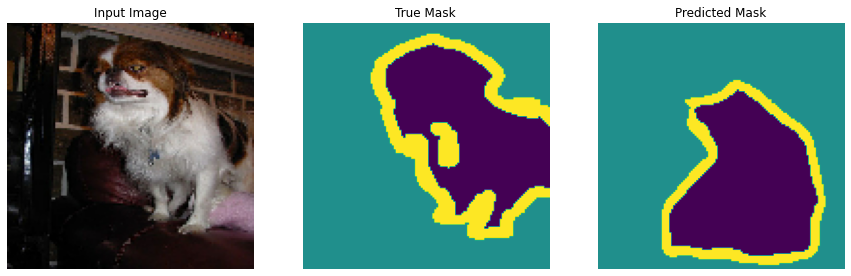

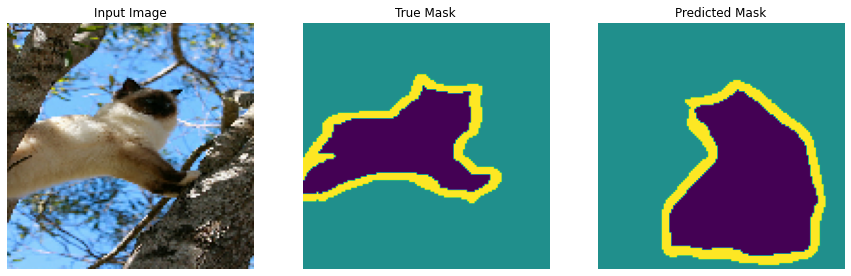

In [ ]:
# To display the list of images with their mask
for image, mask in test_batches.take(11):
  y_pred = unet_best_model.predict(image)
  y_pred = create_mask(y_pred)
  for i in range(0,64):
    display([image[i], mask[i], y_pred])

In [ ]:
# Convert predictions to binary masks
test_preds = (test_preds > 0.5).astype(np.uint8)

# Evaluate performance using common metrics
test_loss, test_acc = model.evaluate(test_images, test_masks, verbose=0)
test_cm = confusion_matrix(test_masks.flatten(), test_preds.flatten())
test_cr = classification_report(test_masks.flatten(), test_preds.flatten())

print('Test loss:', test_loss)
print('Test accuracy:', test_acc)
print('Confusion matrix:\n', test_cm)
print('Classification report:\n', test_cr)